In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns 
sns.set(style='darkgrid', palette='muted')

In [2]:
raw_train = pd.read_csv('train.csv')
raw_test = pd.read_csv('test.csv')

| Variable | Description |
| ------ | ----------- |
|Item_Identifier|	Unique product ID|
|Item_Weight|	Weight of product|
|Item_Fat_Content|	Whether the product is low fat or not|
|Item_Visibility|	The % of total display area of all products in a store allocated to the particular product|
|Item_Type|	The category to which the product belongs|
|Item_MRP|	Maximum Retail Price (list price) of the product|
|Outlet_Identifier|	Unique store ID|
|Outlet_Establishment_Year|	The year in which store was established|
|Outlet_Size|	The size of the store in terms of ground area covered|
|Outlet_Location_Type|	The type of city in which the store is located|
|Outlet_Type|	Whether the outlet is just a grocery store or some sort of supermarket|
|Item_Outlet_Sales|	Sales of the product in the particular store. This is the outcome variable to be predicted.|

In [3]:
raw_train.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800
4,NCD19,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052


In [4]:
raw_train.shape, raw_test.shape

((8523, 12), (5681, 11))

In [5]:
num_col = ['Item_Weight', 'Item_Visibility', 'Item_MRP']
cat_col = ['Item_Fat_Content', 'Item_Type', 'Outlet_Establishment_Year', 'Outlet_Size', 'Outlet_Location_Type', 'Outlet_Type']

In [6]:
raw_train[cat_col].nunique()

Item_Fat_Content              5
Item_Type                    16
Outlet_Establishment_Year     9
Outlet_Size                   3
Outlet_Location_Type          3
Outlet_Type                   4
dtype: int64

In [7]:
raw_train[num_col].describe()

,Item_Weight,Item_Visibility,Item_MRP
count,7060.000000,8523.000000,8523.000000
mean,12.857645,0.066132,140.992782
std,4.643456,0.051598,62.275067
min,4.555000,0.000000,31.290000
25%,8.773750,0.026989,93.826500
50%,12.600000,0.053931,143.012800
75%,16.850000,0.094585,185.643700
max,21.350000,0.328391,266.888400


In [8]:
raw_train.corr()

,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year,Item_Outlet_Sales
Item_Weight,1.000000,-0.014048,0.027141,-0.011588,0.014123
Item_Visibility,-0.014048,1.000000,-0.001315,-0.074834,-0.128625
Item_MRP,0.027141,-0.001315,1.000000,0.005020,0.567574
Outlet_Establishment_Year,-0.011588,-0.074834,0.005020,1.000000,-0.049135
Item_Outlet_Sales,0.014123,-0.128625,0.567574,-0.049135,1.000000


In [9]:
raw_train[cat_col].astype('str').describe(include='all')

,Item_Fat_Content,Item_Type,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type
count,8523,8523,8523,8523,8523,8523
unique,5,16,9,4,3,4
top,Low Fat,Fruits and Vegetables,1985,Medium,Tier 3,Supermarket Type1
freq,5089,1232,1463,2793,3350,5577


In [10]:
na_col = pd.DataFrame(raw_train[num_col+cat_col].isna().sum()) / raw_train.shape[0]*100
na_col.columns = ['NA Train']
na_col['NA Test'] = raw_test[num_col+cat_col].isna().sum().values /raw_train.shape[0]*100
round(na_col, 2)

,NA Train,NA Test
Item_Weight,17.17,11.45
Item_Visibility,0.00,0.00
Item_MRP,0.00,0.00
Item_Fat_Content,0.00,0.00
Item_Type,0.00,0.00
Outlet_Establishment_Year,0.00,0.00
Outlet_Size,28.28,18.84
Outlet_Location_Type,0.00,0.00
Outlet_Type,0.00,0.00


Text(0.5, 0, '')

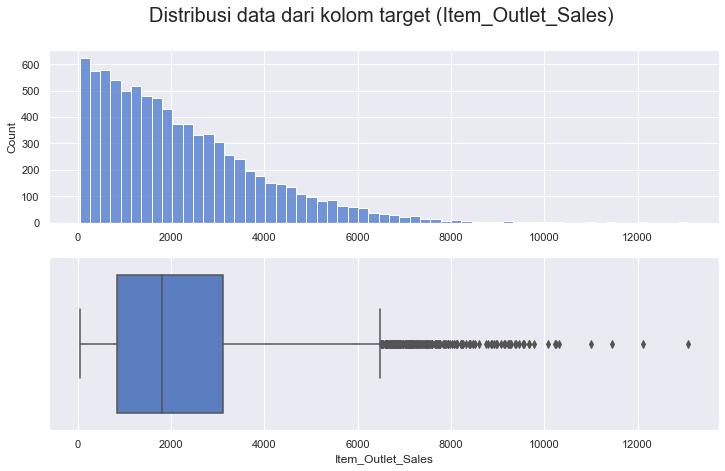

In [11]:
fig, ax = plt.subplots(2, 1, figsize=(12,7))
sns.histplot(raw_train.Item_Outlet_Sales, ax=ax[0])
sns.boxplot(raw_train.Item_Outlet_Sales, ax=ax[1])
ax[0].set_title('Distribusi data dari kolom target (Item_Outlet_Sales) \n', fontsize=20)
ax[0].set_xlabel('')

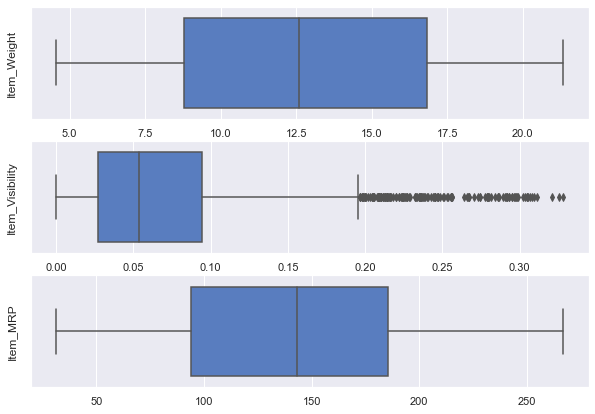

In [12]:
plt.figure(figsize=(10,7))
for i, col in enumerate(num_col):
    plt.subplot(3,1,i+1)
    sns.boxplot(raw_train[col])
    plt.xlabel('')
    plt.ylabel(col)

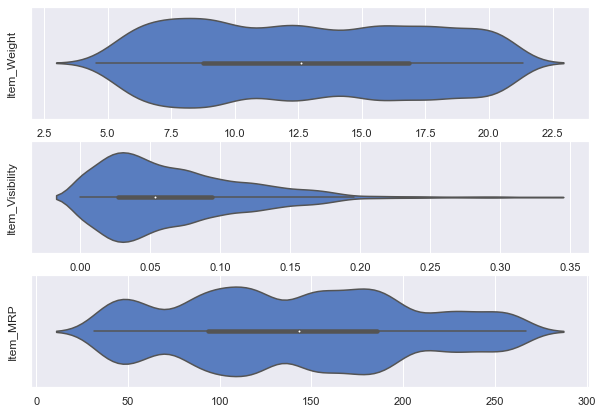

In [13]:
plt.figure(figsize=(10,7))
for i, col in enumerate(num_col):
    plt.subplot(3,1,i+1)
    sns.violinplot(raw_train[col])
    plt.xlabel('')
    plt.ylabel(col)

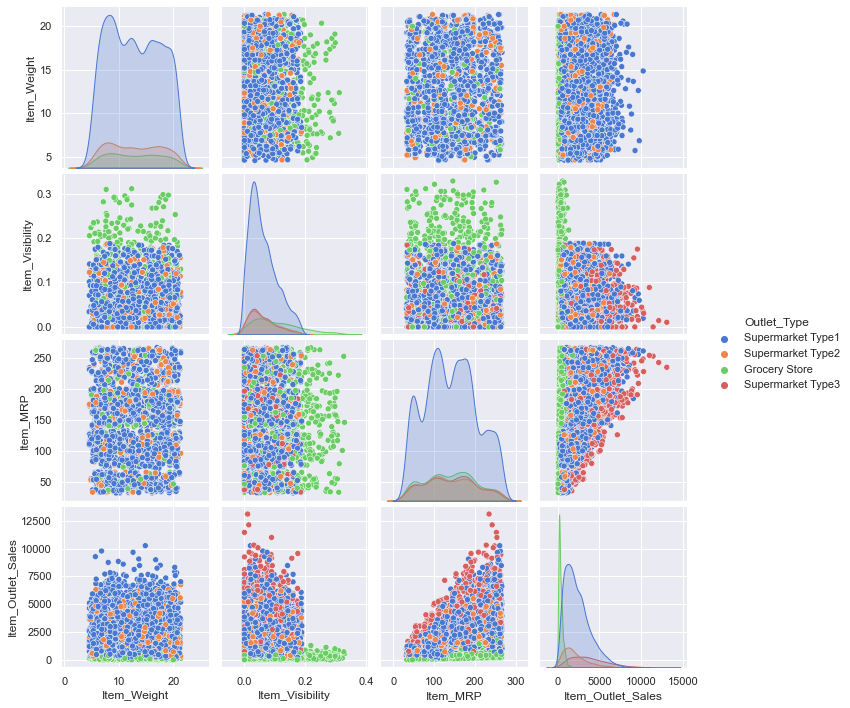

In [14]:
sns.pairplot(raw_train.drop(columns='Outlet_Establishment_Year'), hue='Outlet_Type')

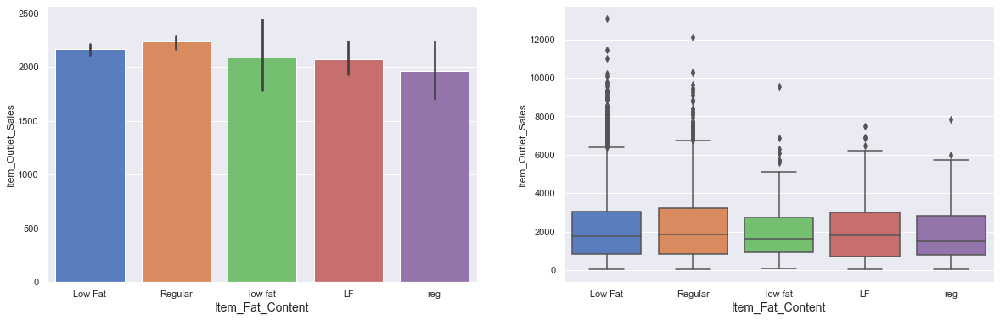

In [26]:
plt.figure(figsize=(20,6))
plt.subplot(1,2,1)
sns.barplot(data=raw_train, y='Item_Outlet_Sales', x='Item_Fat_Content')
plt.xlabel('Item_Fat_Content', fontsize=14)

plt.subplot(1,2,2)
sns.boxplot(data=raw_train, y='Item_Outlet_Sales', x='Item_Fat_Content')
plt.xlabel('Item_Fat_Content', fontsize=14)
plt.show()

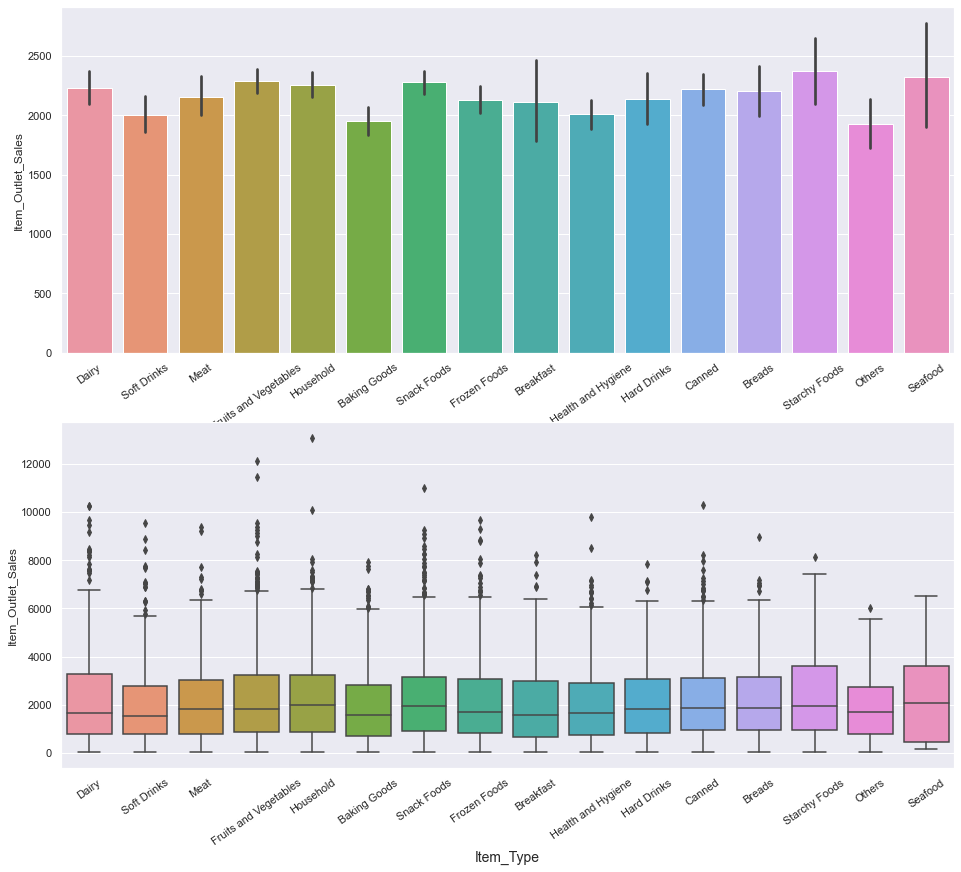

In [33]:
plt.figure(figsize=(16,14))
plt.subplot(2,1,1)
sns.barplot(data=raw_train, y='Item_Outlet_Sales', x='Item_Type')
plt.xlabel('Item_Type', fontsize=14)
plt.xticks(rotation=35)

plt.subplot(2,1,2)
sns.boxplot(data=raw_train, y='Item_Outlet_Sales', x='Item_Type')
plt.xlabel('Item_Type', fontsize=14)
plt.xticks(rotation=35)
plt.show()

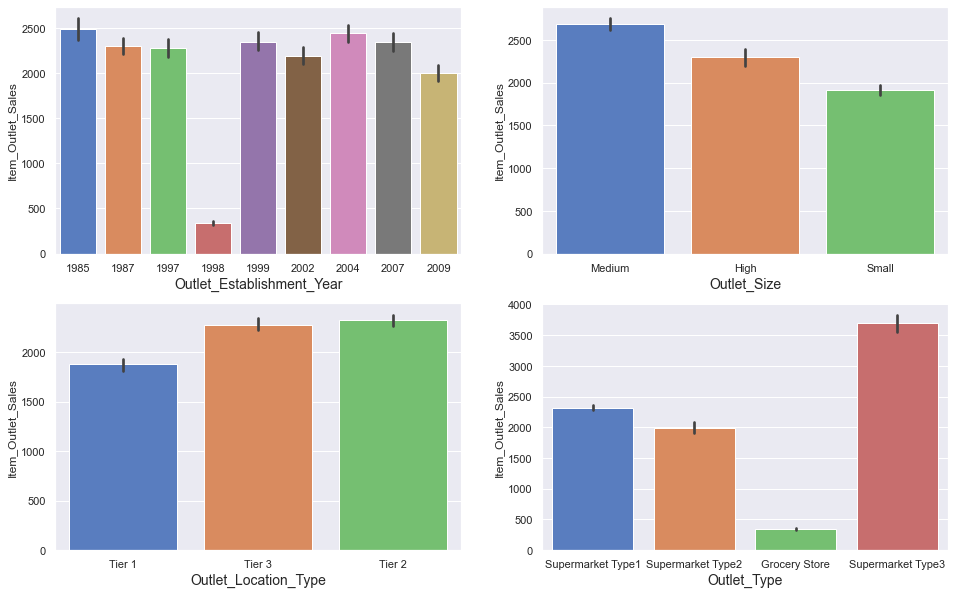

In [16]:
plt.figure(figsize=(16,10))
temp_col = ['Outlet_Establishment_Year', 'Outlet_Size', 'Outlet_Location_Type', 'Outlet_Type']
for i, col in enumerate(temp_col):
    plt.subplot(2,2,i+1)
    sns.barplot(data=raw_train, y='Item_Outlet_Sales', x=col)
    plt.xlabel(col, fontsize=14)

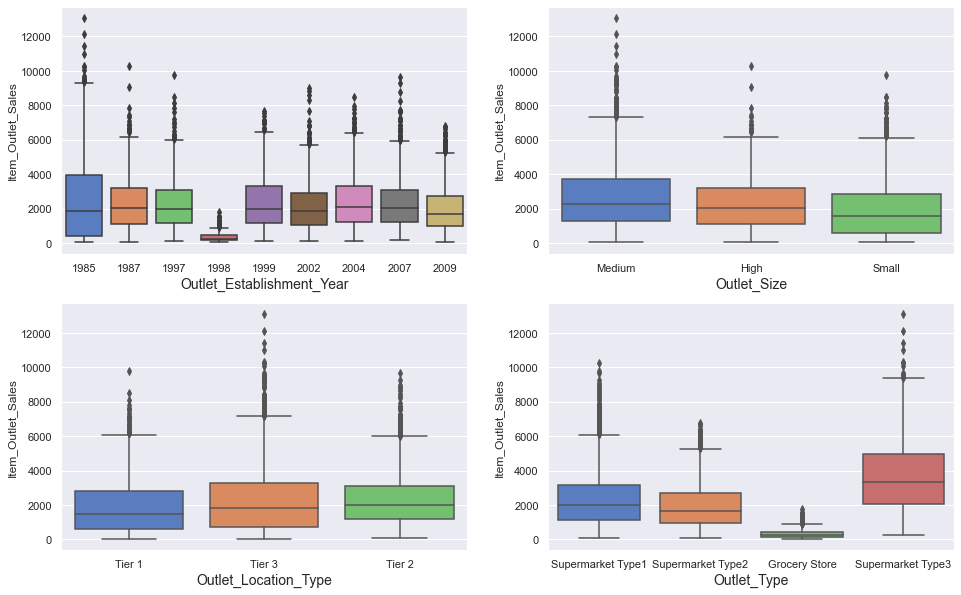

In [21]:
plt.figure(figsize=(16,10))
temp_col = ['Outlet_Establishment_Year', 'Outlet_Size', 'Outlet_Location_Type', 'Outlet_Type']
for i, col in enumerate(temp_col):
    plt.subplot(2,2,i+1)
    sns.boxplot(data=raw_train, y='Item_Outlet_Sales', x=col)
    plt.xlabel(col, fontsize=14)

## Preprocessing

In [39]:
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
import category_encoders as ce
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, learning_curve, cross_validate
from xgboost import XGBRegressor

In [44]:
X = raw_train[num_col+cat_col]
y = raw_train.Item_Outlet_Sales
X_test = raw_test[num_col+cat_col]

In [45]:
na_col = pd.DataFrame(X.isna().sum()) / X.shape[0]*100
na_col.columns = ['NA Train']
na_col['NA Test'] = X_test.isna().sum().values / X_test.shape[0]*100
round(na_col, 2)

,NA Train,NA Test
Item_Weight,17.17,17.18
Item_Visibility,0.00,0.00
Item_MRP,0.00,0.00
Item_Fat_Content,0.00,0.00
Item_Type,0.00,0.00
Outlet_Establishment_Year,0.00,0.00
Outlet_Size,28.28,28.27
Outlet_Location_Type,0.00,0.00
Outlet_Type,0.00,0.00


Kita akan membuang variabel Outlet_Size karena missing valuenya terlalu banyak.

In [46]:
X.drop('Outlet_Size', axis=1, inplace=True)
X_test.drop('Outlet_Size', axis=1, inplace=True)

In [53]:
num_col = ['Item_Weight', 'Item_Visibility', 'Item_MRP']
cat_col = ['Item_Fat_Content', 'Item_Type', 'Outlet_Establishment_Year', 'Outlet_Location_Type', 'Outlet_Type']

numerical_transformer = SimpleImputer(strategy='median')

categorical_transformer = Pipeline(steps=[
    ('imputer2', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(sparse=False, handle_unknown='ignore'))
])

preprocessor = ColumnTransformer(transformers=[
    ('num', numerical_transformer, num_col),
    ('cat', categorical_transformer, cat_col)
])

In [54]:
preprocessor.fit(X)
X_clean = preprocessor.transform(X)
X_test_clean = preprocessor.transform(X_test)

In [62]:
parameters = {
                'n_estimators': [100, 200, 300, 400, 500],
                'learning_rate': [0.006, 0.01, 0.03, 0.06, 0.1]
             }

grid_search = GridSearchCV(estimator = XGBRegressor(),
                           param_grid = parameters,
                           scoring = 'neg_mean_absolute_error',
                           cv = 10)
grid_search.fit(X_clean,y)
print(grid_search.best_score_)
print(grid_search.best_params_)

-756.6328278158131
{'learning_rate': 0.03, 'n_estimators': 100}


In [57]:
submit = pd.read_csv('sample_submission.csv')
submit.columns

Index(['Item_Identifier', 'Outlet_Identifier', 'Item_Outlet_Sales'], dtype='object')

In [59]:
pred_test = grid_search.predict(X_test_clean)
output = pd.DataFrame({'Item_Identifier': raw_test['Item_Identifier'],
                       'Outlet_Identifier': raw_test['Outlet_Identifier'],
                       'Item_Outlet_Sales': pred_test})
output.to_csv('submission.csv', index=False)